## Scientific Assessment and Uncertainty Quantification (UQ) for the Energy Indicator Application (DE340.15.1.3)

This notebook provides insights on **how well the climate variables and indicators**, derived from various Climate DT simulations tailored to the wind energy sector, **capture the spatio-temporal characteristics** compared to reference data (ERA5).

---

### Climate DT Simulations Used

1. **Freeze run (a24r) and 3-member historical ensemble simulations**  
   *Period:* 1990–2014 (25 years)  
   *Model:* IFS-NEMO  
   *Resolution:* Global, 10 km horizontal 


2. **Freeze run control simulation (a267)**  
   *Period:* 1990–2019 (30 years)  
   *Model:* IFS-NEMO  
   *Resolution:* Global, 10 km horizontal  

---

### Scientific Assessment and UQ Components

- **Comparison with ERA5**
- **Mean Bias (MB)**
- **Root Mean Square Error (RMSE)**
- **Pair-wise difference** between each ensemble member and freeze run

---

### Methodology

Climate DT simulations are **regridded to the ERA5 grid** using a conservative regridding technique for wind speed and related indicators.  
*Reference:* Ramon et al., 2019 – [https://doi.org/10.1002/qj.3616](https://doi.org/10.1002/qj.3616)

---

### Contact

📧 **energy-destine@bsc.es**    

**Responsible:** Sushovan Ghosh (BSC)


In [62]:
#libraries
import xarray as xr
import xesmf as xe
import os
# For Jupyter Notebooks
import warnings
warnings.filterwarnings("ignore")

In [63]:
#Plotting libraries

import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.util import add_cyclic_point
from cmocean import cm as cmo
import matplotlib as mpl
from matplotlib import cm
import matplotlib.pyplot as pltmask
import matplotlib.gridspec as gs
from matplotlib.ticker import ScalarFormatter
import matplotlib.patches as patches
import matplotlib.colors as mpc
import xesmf as xe
%matplotlib inline


### Climate Simulation

- **Freeze run (a24r)**  
  *Period:* 1990–2019 (30 years)  
  *Model:* IFS-NEMO  
  *Resolution:* Global, 10 km horizontal  

- **3-member historical ensemble simulations**  
  *Period:* 1990–2014 (25 years)  
  *Model:* IFS-NEMO  
  *Resolution:* Global, 10 km horizontal  

#### Files Used

1. **Reference Data:** Monthly mean of ERA5 *(Postprocessed)*  
2. **Climate DT:** Monthly mean of historical ensemble and historical freeze-run *(Postprocessed)*

#### Variable of Interest

- **Wind speed at 100 m**


**Regridder function** 

 **Bias and RMSE**

In [24]:
import os
import xarray as xr
import numpy as np
import xesmf as xe

def regrid_model_to_era5(model_path, era5_path, output_path):
    # Load datasets
    model_ds = xr.open_dataset(model_path)
    era5_ds = xr.open_dataset(era5_path)

    # Extract model variable
    if "ws_yearly_mean" in model_ds:
        model_var = model_ds["ws_yearly_mean"]
    elif "ws_monthly_mean" in model_ds:
        model_var = model_ds["ws_monthly_mean"]
    else:
        raise KeyError("No valid wind speed variable found in model file.")
    # pick the ERA5 wind‑speed field
    if "windagl100_yearly_mean" in era5_ds:
        era5_var = era5_ds["windagl100_yearly_mean"]
    elif "windagl100" in era5_ds:
        era5_var = era5_ds["windagl100"]
    else:
        raise KeyError("Neither 'windagl100_yearly_mean' nor 'windagl100' found in the ERA5 file.")


    # Setup regridder
    regridder = xe.Regridder(model_var, era5_var, method="conservative", periodic=True, reuse_weights=False)

    # Perform regridding
    regridded = regridder(model_var)
    regridded.name = "ws_regridded"

    # Save output
    regridded.to_netcdf(output_path)
    print(f"✅ Regridded data saved to: {output_path}")
    return regridded, era5_var

def compute_bias_rmse(regridded, reference):
    # Align time if necessary
    regridded, reference = xr.align(regridded, reference, join="inner")

    bias = (regridded - reference).mean(dim="time")
    rmse = np.sqrt(((regridded - reference) ** 2).mean(dim="time"))
    return bias, rmse


**Plotting function**

In [25]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.util import add_cyclic_point
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap
#import cartopy.mpl.ticker as cticker
# add this import at the top of the file
import matplotlib.ticker as mticker


def plot_ensemble_panels(
    da_list,
    titles=None,
    vmin=None,
    vmax=None,
    cmap="YlGnBu",
    extend=None,
    cbar_label="Wind speed (m s⁻¹)",
    fig_title=None,
    projection="robinson",
    grid_interval=None,          # e.g. 30 will draw 30° grid
):
    """
    Plot 4 DataArrays (lat, lon) in a 1×4 panel with common colour‑bar.
    """

    if len(da_list) != 4:
        raise ValueError("da_list must contain exactly 4 DataArrays.")
    if vmin is None or vmax is None:
        raise ValueError("vmin and vmax must be specified.")

    proj = {
        "robinson": ccrs.Robinson(),
        "mollweide": ccrs.Mollweide(),
        "platecarree": ccrs.PlateCarree(),
    }.get(projection.lower(), ccrs.PlateCarree())

    if titles is None:
        titles = ["Ens‑1", "Ens‑2", "Ens‑3", "Ensemble Mean"]

    cmap = get_cmap(cmap)
    norm = Normalize(vmin=vmin, vmax=vmax)

    fig, axes = plt.subplots(
        1, 4, figsize=(20, 4.8), subplot_kw={"projection": proj}
    )

    for ax, da, ttl in zip(axes, da_list, titles):
        # Add cyclic point to avoid seam
        var, lons = add_cyclic_point(da.values, coord=da.lon.values)
        lon2d, lat2d = np.meshgrid(lons, da.lat.values)

        mesh = ax.pcolormesh(
            lon2d,
            lat2d,
            var,
            transform=ccrs.PlateCarree(),
            cmap=cmap,
            norm=norm,
        )
        ax.set_title(ttl, fontsize=12)

        # coastlines & land
        ax.coastlines(linewidth=0.6)
        ax.add_feature(cfeature.BORDERS, linewidth=0.4)
        ax.add_feature(
            cfeature.LAND, facecolor="whitesmoke", edgecolor="black"
        )

        # gridlines
        #gl = ax.gridlines(
            #draw_labels=True,
            #linewidth=0.3,
            #color="gray",
            #alpha=0.4,
            #linestyle="--",
        #)
        # Gridlines
        gl = ax.gridlines(draw_labels=True, linewidth=0.4, color='gray', alpha=0.5, linestyle='--')
        gl.top_labels = False
        gl.right_labels = False
        gl.xlabel_style = {'size': 9}
        gl.ylabel_style = {'size': 9}
        if grid_interval:
            gl.xlocator = mticker.FixedLocator(np.arange(-180, 181, grid_interval))
            gl.ylocator = mticker.FixedLocator(np.arange(-90, 91, grid_interval))

    # shared colour‑bar
    cax = fig.add_axes([0.18, 0.08, 0.64, 0.04])
    cbar = fig.colorbar(mesh, cax=cax, orientation="horizontal", extend=extend)
    cbar.set_label(cbar_label, fontsize=12)
    cbar.ax.tick_params(labelsize=10)

    if fig_title:
        plt.suptitle(fig_title, fontsize=16, fontweight="bold", y=0.97)

    plt.tight_layout(rect=[0, 0.13, 1, 0.95])
    plt.show()


**Regridding of ensemble member and its mean**

In [11]:
# === USAGE ===
model_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_a2gb_1990_2014.nc"
era5_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_yearly_mean_1990_2014.nc"
regridded_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_member_a2gb_regridded_to_era5_1990_2014.nc"

# Step 1: Regrid
regridded_model, era5_data = regrid_model_to_era5(model_path, era5_path, regridded_path)

# Step 2: Compute bias and RMSE
mean_bias_a2gb, rmse_a2gb = compute_bias_rmse(regridded_model, era5_data)



✅ Regridded data saved to: /gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_member_a2gb_regridded_to_era5_1990_2014.nc


In [14]:
# === USAGE ===
model_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_a2gc_1990_2014.nc"
era5_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_yearly_mean_1990_2014.nc"
regridded_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_member_a2gc_regridded_to_era5_1990_2014.nc"

# Step 1: Regrid
regridded_model, era5_data = regrid_model_to_era5(model_path, era5_path, regridded_path)

# Step 2: Compute bias and RMSE
mean_bias_a2gc, rmse_a2gc = compute_bias_rmse(regridded_model, era5_data)



✅ Regridded data saved to: /gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_member_a2gc_regridded_to_era5_1990_2014.nc


In [16]:
# === USAGE ===
era5_file = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_yearly_mean_1990_2014.nc"
model_file = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_a2gd_regridded_to_era5_1990_2014.nc"

ds_era5 = xr.open_dataset(era5_file)
ds_model = xr.open_dataset(model_file)

# Extract data arrays
era5 = ds_era5["windagl100_yearly_mean"]
model = ds_model["ws_regridded"]

# Compute monthly bias and rmse
mean_bias_a2gd = (model - era5).mean(dim="time")
rmse_a2gd = np.sqrt(((model - era5) ** 2).mean(dim="time"))


In [17]:
import xarray as xr

# Load ERA5 and model regridded data
era5_file = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_yearly_mean_1990_2014.nc"
model_file = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_ensemble_regridded_to_era5_1990_2014.nc"

ds_era5 = xr.open_dataset(era5_file)
ds_model = xr.open_dataset(model_file)

# Extract data arrays
era5 = ds_era5["windagl100_yearly_mean"]
model = ds_model["ws_yearly_mean_ensemble"]

# Compute monthly bias
mean_bias_ensem = (model - era5).mean(dim="time")
rmse_ensem = np.sqrt(((model - era5) ** 2).mean(dim="time"))

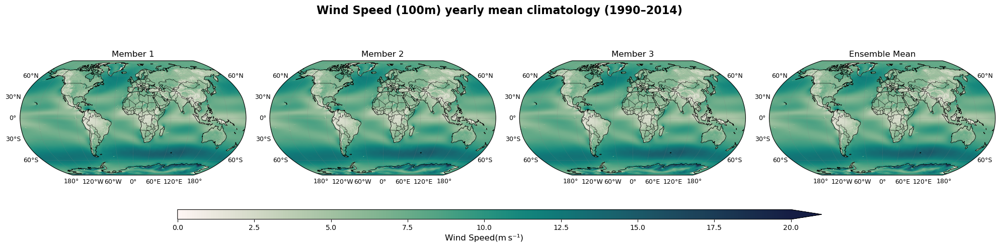

In [13]:
import cmocean
import xarray as xr
from glob import glob

# paths
ens_paths = sorted(
    glob("/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_a2g[bc,d]_regridded_to_era5_1990_2014.nc")
)
mean_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_ensemble_regridded_to_era5_1990_2014.nc"

# load member means (average over time dimension)
members = [
    xr.open_dataset(p)["ws_regridded"].mean("time") for p in ens_paths
]

# load ensemble mean
ens_mean = xr.open_dataset(mean_path)["ws_yearly_mean_ensemble"].mean("time")

# plot
plot_ensemble_panels(
    da_list=members + [ens_mean],
    titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
    vmin=0,
    vmax=20,
    cmap=cmocean.cm.tempo,
    extend="max",
    cbar_label="Wind Speed(m s⁻¹)",
    fig_title="Wind Speed (100m) yearly mean climatology (1990–2014)",
    projection="robinson",
    grid_interval=30,   # optional: 30° × 30° grid
)


**Bias and RMSE Plotting**

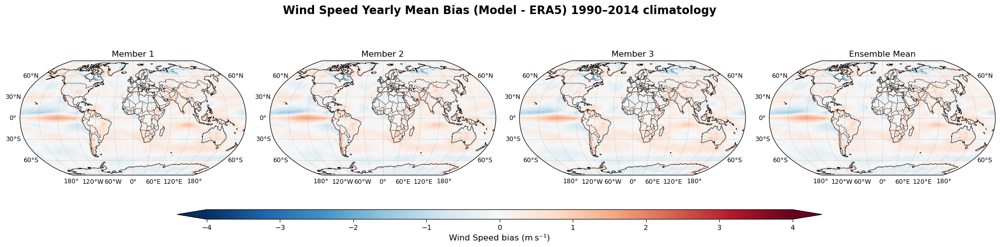

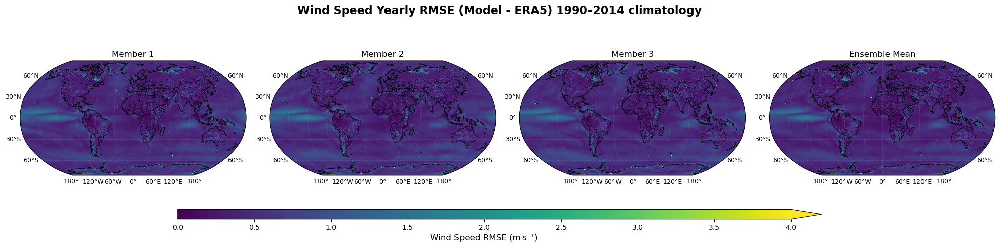

In [21]:
# -----------------------------------------------------------------------
# 1.  Gather the 2‑D DataArrays into a list                (lat × lon)
# -----------------------------------------------------------------------
bias_list = [mean_bias_a2gb, mean_bias_a2gc, mean_bias_a2gd, mean_bias_ensem]     # already loaded!

# If you also have RMSE arrays:
rmse_list = [rmse_a2gb, rmse_a2gc, rmse_a2gd, rmse_ensem]

# -----------------------------------------------------------------------
# 2.  Choose colour limits (symmetric around 0 for bias)
# -----------------------------------------------------------------------
bias_absmax = float(abs(xr.concat(bias_list, dim="stack").max()))
#print(f"Bias global max  ±{bias_absmax:.2f}")

# -----------------------------------------------------------------------
# 3.  Plot bias (diverging colormap, zero‑centred)
# -----------------------------------------------------------------------
plot_ensemble_panels(
    da_list=bias_list,
    titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
    vmin=-4, #-bias_absmax
    vmax= 4, # bias_absmax
    cmap="RdBu_r",                         # diverging, 0 in centre
    extend="both",
    cbar_label="Wind Speed bias (m s⁻¹)",
    fig_title="Wind Speed Yearly Mean Bias (Model - ERA5) 1990–2014 climatology",
    projection="robinson",
    grid_interval=30,
)

# -----------------------------------------------------------------------
# 4.  Plot RMSE if you have them (positive‑definite colormap)
# -----------------------------------------------------------------------
rmse_max = float(xr.concat(rmse_list, dim="stack").max())
plot_ensemble_panels(
     da_list=rmse_list,
     titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
     vmin=0,
     vmax=4,#np.ceil(rmse_max),
     cmap="viridis",                  # perceptually uniform for >0
     extend="max",
     cbar_label="Wind Speed RMSE (m s⁻¹)",
     fig_title="Wind Speed Yearly RMSE (Model - ERA5) 1990–2014 climatology",
     projection="robinson",
     grid_interval=30,
 )


**Seasonal Bias and RMSE**

In [26]:
import os
import glob
import numpy as np
import xarray as xr
from typing import Dict


def calc_member_bias_rmse(
    season: str,
    base_dir: str = "/gpfs/scratch/bsc32/bsc148104/hist_ensem",
    push_globals: bool = True,
) -> tuple[Dict[str, xr.DataArray], Dict[str, xr.DataArray]]:
    """
    Compute seasonal‐mean bias and RMSE (member − ERA5) for a2g* ensembles.

    Returns
    -------
    bias  : dict {member_tag: DataArray(lat, lon)}
    rmse  : dict {member_tag: DataArray(lat, lon)}

    Notes
    -----
    * Looks for files named
        ws_seasonal_climatology_a2g?_regridded_to_era5_1990_2014_<SEASON>.nc
    * ERA5 file:
        windagl100_seasonal_climatology_1990_2014_<SEASON>.nc
    * Ensemble‑mean file (optional):
        ws_seasonal_climatology_ensemble_regridded_to_era5_1990_2014_<SEASON>.nc
    """
    # ------------------------------------------------ ERA5 reference
    era5_file = f"{base_dir}/windagl100_seasonal_climatology_1990_2014_{season}.nc"
    era5_da = xr.open_dataset(era5_file).to_array().squeeze()  # any variable

    # ------------------------------------------------ ensemble members
    member_pat = (
        f"{base_dir}/ws_seasonal_climatology_a2g?_regridded_to_era5_1990_2014_{season}.nc"
    )
    bias, rmse = {}, {}

    for mfile in sorted(glob.glob(member_pat)):
        tag = os.path.basename(mfile).split("_")[3]  # 'a2gb', 'a2gc', 'a2gd'
        mod_da = xr.open_dataset(mfile).to_array().squeeze()

        mod_al, era_al = xr.align(mod_da, era5_da, join="exact")

        bias[tag] = (mod_al - era_al).mean("time")
        rmse[tag] = np.sqrt(((mod_al - era_al) ** 2).mean("time"))

        if push_globals:
            globals()[f"mean_bias_{tag}_{season}"] = bias[tag]
            globals()[f"rmse_{tag}_{season}"] = rmse[tag]

        print(f"✓ processed member {tag}")

    # --------------------------------------------- optional ensemble mean
    ens_file = (
        f"{base_dir}/ws_seasonal_climatology_ensemble_regridded_to_era5_1990_2014_{season}.nc"
    )
    if os.path.exists(ens_file):
        ens_da = xr.open_dataset(ens_file).to_array().squeeze()
        ens_al, era_al = xr.align(ens_da, era5_da, join="exact")

        bias["ensem"] = (ens_al - era_al).mean("time")
        rmse["ensem"] = np.sqrt(((ens_al - era_al) ** 2).mean("time"))

        if push_globals:
            globals()[f"mean_bias_ensem_{season}"] = bias["ensem"]
            globals()[f"rmse_ensem_{season}"] = rmse["ensem"]

        print("✓ processed ensemble mean")
    else:
        print("⚠️ ensemble NetCDF not found — ensemble bias/RMSE skipped")

    return bias, rmse


# ───────────────────────── example call ─────────────────────────
#bias_MAM, rmse_MAM = calc_member_bias_rmse("MAM")

#print("✅ variables & dictionaries ready for plotting")


In [29]:
bias_MAM, rmse_MAM = calc_member_bias_rmse("MAM")

print("✅ variables & dictionaries ready for plotting")

✓ processed member a2gb
✓ processed member a2gc
✓ processed member a2gd
✓ processed ensemble mean
✅ variables & dictionaries ready for plotting


In [30]:
bias_DJF, rmse_DJF = calc_member_bias_rmse("DJF")

print("✅ variables & dictionaries ready for plotting")

✓ processed member a2gb
✓ processed member a2gc
✓ processed member a2gd
✓ processed ensemble mean
✅ variables & dictionaries ready for plotting


In [31]:
bias_JJA, rmse_JJA = calc_member_bias_rmse("JJA")

print("✅ variables & dictionaries ready for plotting")

✓ processed member a2gb
✓ processed member a2gc
✓ processed member a2gd
✓ processed ensemble mean
✅ variables & dictionaries ready for plotting


In [32]:
bias_SON, rmse_SON = calc_member_bias_rmse("SON")

print("✅ variables & dictionaries ready for plotting")

✓ processed member a2gb
✓ processed member a2gc
✓ processed member a2gd
✓ processed ensemble mean
✅ variables & dictionaries ready for plotting


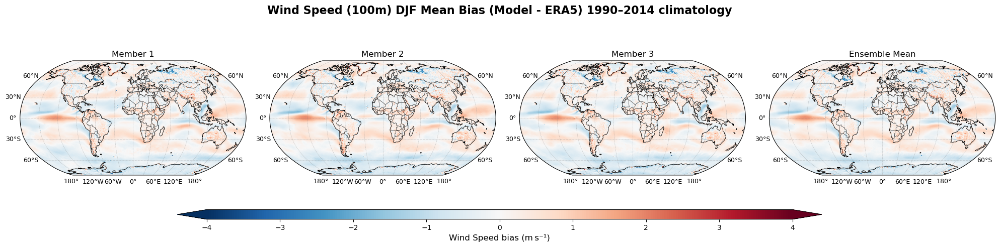

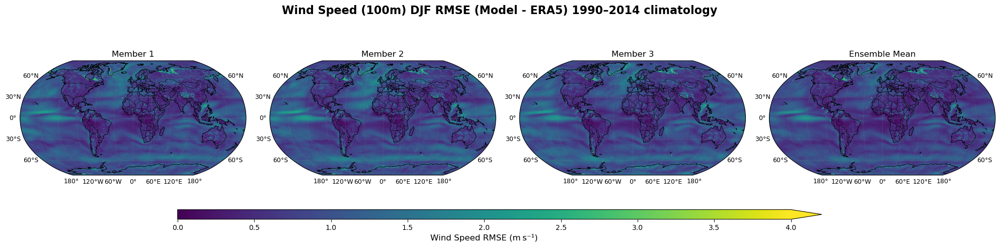

In [34]:
# -----------------------------------------------------------------------
# 1.  Gather the 2‑D DataArrays into a list                (lat × lon)
# -----------------------------------------------------------------------
bias_list = [bias_DJF[t] for t in ("a2gb", "a2gc", "a2gd", "ensem")] # already loaded!

# If you also have RMSE arrays:
rmse_list = [rmse_DJF[t] for t in ("a2gb", "a2gc", "a2gd", "ensem")]

# -----------------------------------------------------------------------
# 2.  Choose colour limits (symmetric around 0 for bias)
# -----------------------------------------------------------------------
bias_absmax = float(abs(xr.concat(bias_list, dim="stack").max()))
#print(f"Bias colourM RMSE scale ±{bias_absmax:.2f}")

# -----------------------------------------------------------------------
# 3.  Plot bias (diverging colormap, zero‑centred)
# -----------------------------------------------------------------------
plot_ensemble_panels(
    da_list=bias_list,
    titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
    vmin= -4, #-bias_absmax,
    vmax= 4,  #bias_absmax,
    cmap="RdBu_r",                         # diverging, 0 in centre
    extend="both",
    cbar_label="Wind Speed bias (m s⁻¹)",
    fig_title="Wind Speed (100m) DJF Mean Bias (Model - ERA5) 1990–2014 climatology",
    projection="robinson",
    grid_interval=30,
)

# -----------------------------------------------------------------------
# 4.  Plot RMSE if you have them (positive‑definite colormap)
# -----------------------------------------------------------------------
rmse_max = float(xr.concat(rmse_list, dim="stack").max())
plot_ensemble_panels(
     da_list=rmse_list,
     titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
     vmin=0,
     vmax=4, #np.ceil(rmse_max),
     cmap="viridis",                  # perceptually uniform for >0
     extend="max",
     cbar_label="Wind Speed RMSE (m s⁻¹)",
     fig_title="Wind Speed (100m) DJF RMSE (Model - ERA5) 1990–2014 climatology",
     projection="robinson",
     grid_interval=30,
 )


Bias colourM RMSE scale ±9.79


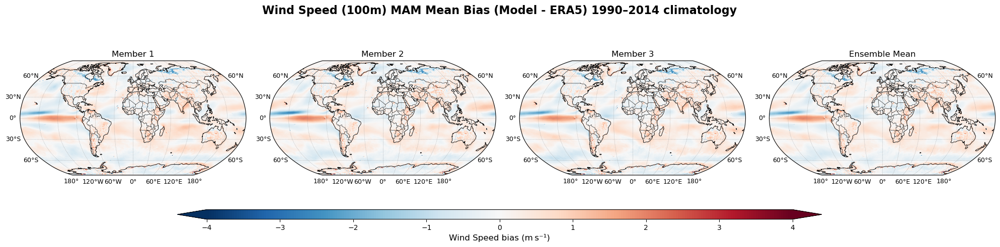

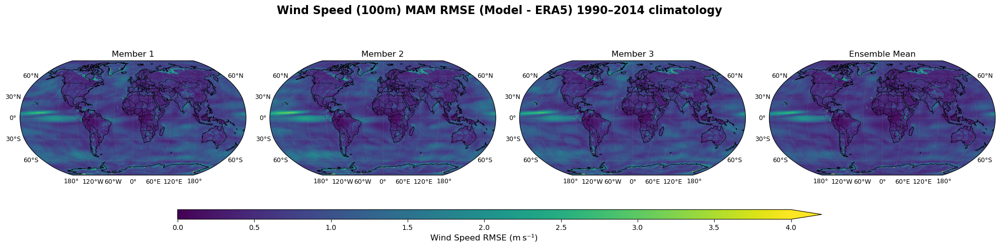

In [33]:
# -----------------------------------------------------------------------
# 1.  Gather the 2‑D DataArrays into a list                (lat × lon)
# -----------------------------------------------------------------------
bias_list = [bias_MAM[t] for t in ("a2gb", "a2gc", "a2gd", "ensem")] # already loaded!

# If you also have RMSE arrays:
rmse_list = [rmse_MAM[t] for t in ("a2gb", "a2gc", "a2gd", "ensem")]

# -----------------------------------------------------------------------
# 2.  Choose colour limits (symmetric around 0 for bias)
# -----------------------------------------------------------------------
bias_absmax = float(abs(xr.concat(bias_list, dim="stack").max()))
#print(f"Bias colourM RMSE scale ±{bias_absmax:.2f}")

# -----------------------------------------------------------------------
# 3.  Plot bias (diverging colormap, zero‑centred)
# -----------------------------------------------------------------------
plot_ensemble_panels(
    da_list=bias_list,
    titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
    vmin= -4, #-bias_absmax,
    vmax= 4,  #bias_absmax,
    cmap="RdBu_r",                         # diverging, 0 in centre
    extend="both",
    cbar_label="Wind Speed bias (m s⁻¹)",
    fig_title="Wind Speed (100m) MAM Mean Bias (Model - ERA5) 1990–2014 climatology",
    projection="robinson",
    grid_interval=30,
)

# -----------------------------------------------------------------------
# 4.  Plot RMSE if you have them (positive‑definite colormap)
# -----------------------------------------------------------------------
rmse_max = float(xr.concat(rmse_list, dim="stack").max())
plot_ensemble_panels(
     da_list=rmse_list,
     titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
     vmin=0,
     vmax=4, #np.ceil(rmse_max),
     cmap="viridis",                  # perceptually uniform for >0
     extend="max",
     cbar_label="Wind Speed RMSE (m s⁻¹)",
     fig_title="Wind Speed (100m) MAM RMSE (Model - ERA5) 1990–2014 climatology",
     projection="robinson",
     grid_interval=30,
 )


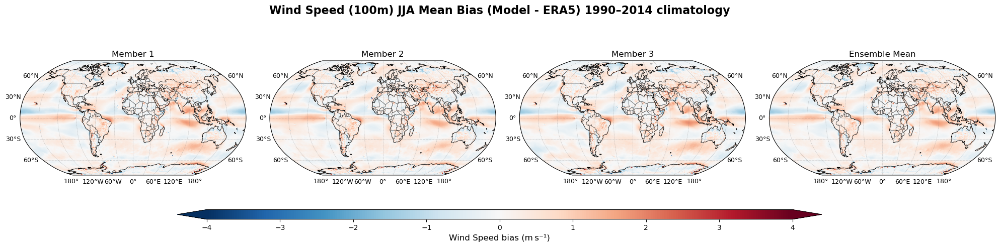

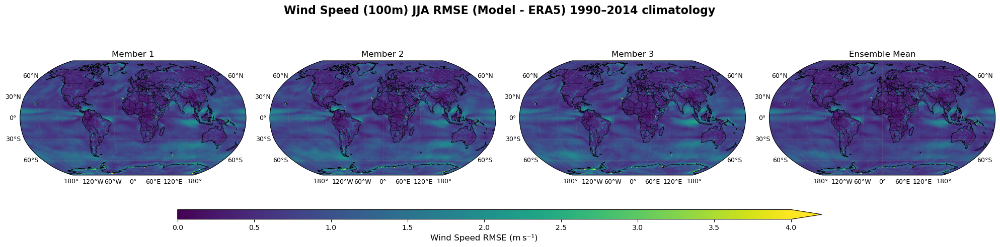

In [35]:
# -----------------------------------------------------------------------
# 1.  Gather the 2‑D DataArrays into a list                (lat × lon)
# -----------------------------------------------------------------------
bias_list = [bias_JJA[t] for t in ("a2gb", "a2gc", "a2gd", "ensem")] # already loaded!

# If you also have RMSE arrays:
rmse_list = [rmse_JJA[t] for t in ("a2gb", "a2gc", "a2gd", "ensem")]

# -----------------------------------------------------------------------
# 2.  Choose colour limits (symmetric around 0 for bias)
# -----------------------------------------------------------------------
bias_absmax = float(abs(xr.concat(bias_list, dim="stack").max()))
#print(f"Bias colourM RMSE scale ±{bias_absmax:.2f}")

# -----------------------------------------------------------------------
# 3.  Plot bias (diverging colormap, zero‑centred)
# -----------------------------------------------------------------------
plot_ensemble_panels(
    da_list=bias_list,
    titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
    vmin= -4, #-bias_absmax,
    vmax= 4,  #bias_absmax,
    cmap="RdBu_r",                         # diverging, 0 in centre
    extend="both",
    cbar_label="Wind Speed bias (m s⁻¹)",
    fig_title="Wind Speed (100m) JJA Mean Bias (Model - ERA5) 1990–2014 climatology",
    projection="robinson",
    grid_interval=30,
)

# -----------------------------------------------------------------------
# 4.  Plot RMSE if you have them (positive‑definite colormap)
# -----------------------------------------------------------------------
rmse_max = float(xr.concat(rmse_list, dim="stack").max())
plot_ensemble_panels(
     da_list=rmse_list,
     titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
     vmin=0,
     vmax=4, #np.ceil(rmse_max),
     cmap="viridis",                  # perceptually uniform for >0
     extend="max",
     cbar_label="Wind Speed RMSE (m s⁻¹)",
     fig_title="Wind Speed (100m) JJA RMSE (Model - ERA5) 1990–2014 climatology",
     projection="robinson",
     grid_interval=30,
 )


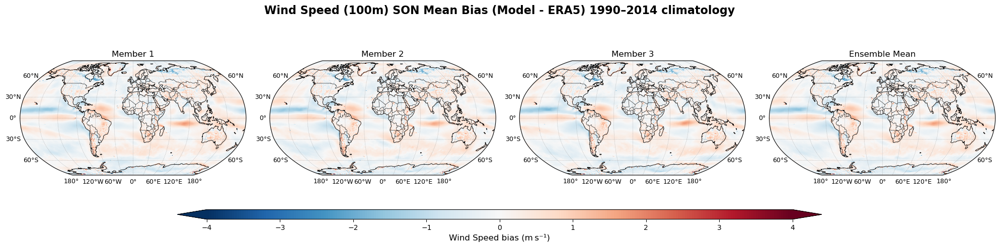

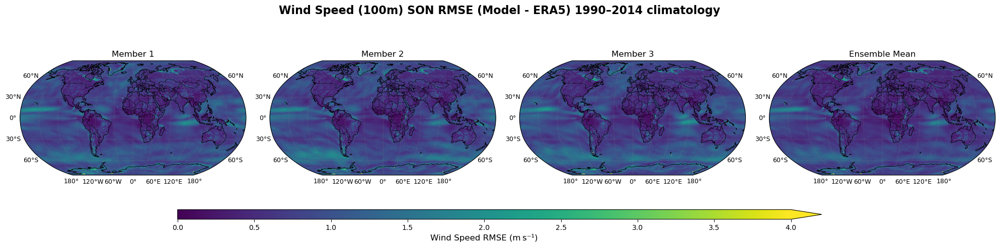

In [36]:
# -----------------------------------------------------------------------
# 1.  Gather the 2‑D DataArrays into a list                (lat × lon)
# -----------------------------------------------------------------------
bias_list = [bias_SON[t] for t in ("a2gb", "a2gc", "a2gd", "ensem")] # already loaded!

# If you also have RMSE arrays:
rmse_list = [rmse_SON[t] for t in ("a2gb", "a2gc", "a2gd", "ensem")]

# -----------------------------------------------------------------------
# 2.  Choose colour limits (symmetric around 0 for bias)
# -----------------------------------------------------------------------
bias_absmax = float(abs(xr.concat(bias_list, dim="stack").max()))
#print(f"Bias colourM RMSE scale ±{bias_absmax:.2f}")

# -----------------------------------------------------------------------
# 3.  Plot bias (diverging colormap, zero‑centred)
# -----------------------------------------------------------------------
plot_ensemble_panels(
    da_list=bias_list,
    titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
    vmin= -4, #-bias_absmax,
    vmax= 4,  #bias_absmax,
    cmap="RdBu_r",                         # diverging, 0 in centre
    extend="both",
    cbar_label="Wind Speed bias (m s⁻¹)",
    fig_title="Wind Speed (100m) SON Mean Bias (Model - ERA5) 1990–2014 climatology",
    projection="robinson",
    grid_interval=30,
)

# -----------------------------------------------------------------------
# 4.  Plot RMSE if you have them (positive‑definite colormap)
# -----------------------------------------------------------------------
rmse_max = float(xr.concat(rmse_list, dim="stack").max())
plot_ensemble_panels(
     da_list=rmse_list,
     titles=["Member 1", "Member 2", "Member 3", "Ensemble Mean"],
     vmin=0,
     vmax=4, #np.ceil(rmse_max),
     cmap="viridis",                  # perceptually uniform for >0
     extend="max",
     cbar_label="Wind Speed RMSE (m s⁻¹)",
     fig_title="Wind Speed (100m) SON RMSE (Model - ERA5) 1990–2014 climatology",
     projection="robinson",
     grid_interval=30,
 )


In [37]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.util import add_cyclic_point
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap
import matplotlib.ticker as mticker


def plot_climatology_panels(
    da_list,
    *,
    titles=None,
    vmin,
    vmax,
    cmap="YlGnBu",
    extend=None,
    cbar_label="",
    fig_title=None,
    projection="robinson",
    grid_interval=None,
):
    """
    Plot 4‑–‑6 lat/lon DataArrays in a 2×3 panel with a shared colour‑bar.

    Parameters
    ----------
    da_list : list[xarray.DataArray]
        Each array must have dims (lat, lon). Length 4–6.
        e.g. [ERA5, member1, member2, member3, ensemble_mean]
    titles : list[str], optional
        One title per panel.  If omitted, generic titles are generated.
    vmin, vmax : float
        Colour limits.
    cmap : str or Colormap
    extend : {"neither", "min", "max", "both"}, optional
        Arrow heads on the colour‑bar.
    cbar_label : str
    fig_title : str
    projection : {"robinson", "mollweide", "platecarree"}
    grid_interval : int, optional
        Degree spacing for labelled gridlines (e.g. 30 → 30 °× 30 °).
    """
    n = len(da_list)
    if n < 4 or n > 6:
        raise ValueError("da_list must contain 4, 5, or 6 DataArrays.")

    if titles is None:
        titles = [f"Panel {i+1}" for i in range(n)]
    if len(titles) != n:
        raise ValueError("titles length must match da_list length.")

    proj = {
        "robinson": ccrs.Robinson(),
        "mollweide": ccrs.Mollweide(),
        "platecarree": ccrs.PlateCarree(),
    }.get(projection.lower(), ccrs.PlateCarree())

    cmap = get_cmap(cmap)
    norm = Normalize(vmin=vmin, vmax=vmax)

    # 2×3 grid – some axes may remain unused
    fig, axes = plt.subplots(2, 3, figsize=(18, 8), subplot_kw=dict(projection=proj))
    
    fig.subplots_adjust(hspace=1.5)   # ← extra gap between the two rows
    axes = axes.ravel()

    # ------------------------------------------------------------------ plotting loop
    for ax, da, ttl in zip(axes, da_list, titles):
        # add a cyclic point to avoid the seam
        var, lons = add_cyclic_point(da.values, coord=da.lon.values)
        lon2d, lat2d = np.meshgrid(lons, da.lat.values)

        mesh = ax.pcolormesh(lon2d, lat2d, var,
                             transform=ccrs.PlateCarree(),
                             cmap=cmap, norm=norm)

        ax.set_title(ttl, fontsize=12)
        ax.coastlines(linewidth=0.6)
        ax.add_feature(cfeature.BORDERS, linewidth=0.4)
        ax.add_feature(cfeature.LAND, facecolor="whitesmoke", edgecolor="black")

        # gridlines
        gl = ax.gridlines(draw_labels=True, linewidth=0.4, color="gray",
                          alpha=0.5, linestyle="--")
        gl.top_labels = False
        gl.right_labels = False
        gl.xlabel_style = {"size": 9}
        gl.ylabel_style = {"size": 9}

        if grid_interval:
            gl.xlocator = mticker.FixedLocator(np.arange(-180, 181, grid_interval))
            gl.ylocator = mticker.FixedLocator(np.arange(-90,  91,  grid_interval))

    # ------------------------------------------------------------------ hide empty panels
    for ax in axes[n:]:
        ax.remove()

    # ------------------------------------------------------------------ shared colour‑bar
    cax = fig.add_axes([0.18, 0.06, 0.64, 0.03])
    cbar = fig.colorbar(mesh, cax=cax, orientation="horizontal", extend=extend)
    cbar.set_label(cbar_label, fontsize=12)
    cbar.ax.tick_params(labelsize=10)

    # ------------------------------------------------------------------ figure title
    if fig_title:
        plt.suptitle(fig_title, fontsize=16, fontweight="bold", y=0.97)

    plt.tight_layout(rect=[0, 0.11, 1, 0.94])
    plt.show()


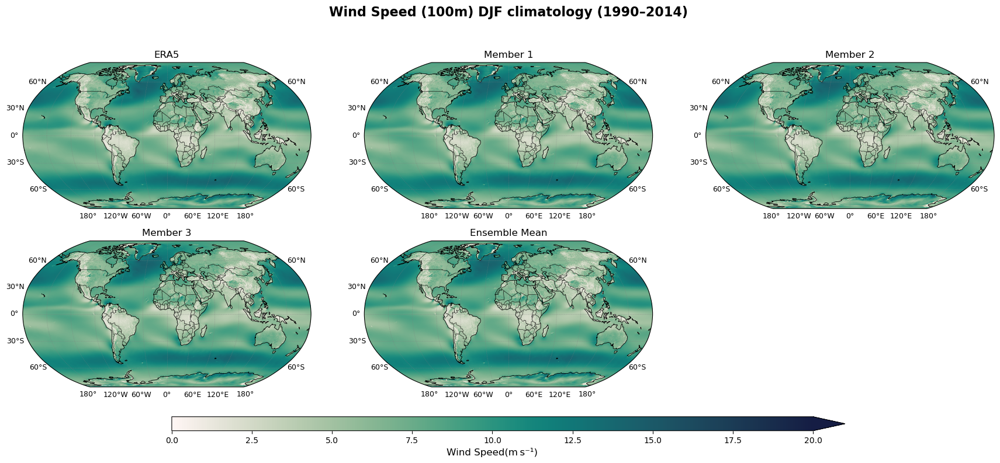

In [38]:
import cmocean
import xarray as xr
from glob import glob

# paths
era5_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_seasonal_climatology_1990_2014_DJF.nc"

ens_paths = sorted(
    glob("/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_climatology_a2g[bc,d]_regridded_to_era5_1990_2014_DJF.nc")
)
mean_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_climatology_ensemble_regridded_to_era5_1990_2014_DJF.nc"

# load member means (average over time dimension)
EAR5_mean=xr.open_dataset(era5_path)["windagl100"].mean("time")

members = [
    xr.open_dataset(p)["ws_regridded"].mean("time") for p in ens_paths
]

# load ensemble mean
ens_mean = xr.open_dataset(mean_path)["ws_seasonal_mean_ensemble"].mean("time")

# plot
plot_climatology_panels(
    da_list=[EAR5_mean]+ members + [ens_mean],
    titles=["ERA5", "Member 1", "Member 2", "Member 3", "Ensemble Mean"],
    vmin=0,
    vmax=20,
    cmap=cmocean.cm.tempo,
    extend="max",
    cbar_label="Wind Speed(m s⁻¹)",
    fig_title="Wind Speed (100m) DJF climatology (1990–2014)",
    projection="robinson",
    grid_interval=30,   # optional: 30° × 30° grid
)


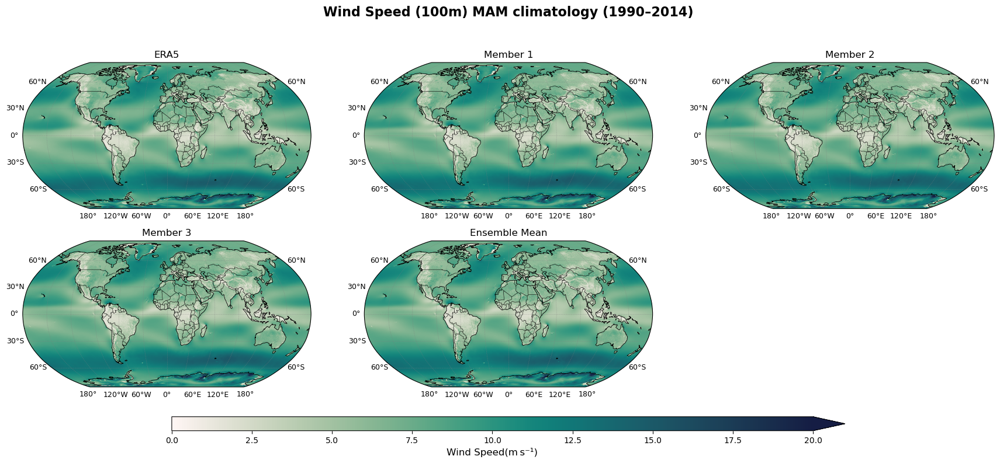

In [39]:
import cmocean
import xarray as xr
from glob import glob

# paths
era5_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_seasonal_climatology_1990_2014_MAM.nc"

ens_paths = sorted(
    glob("/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_climatology_a2g[bc,d]_regridded_to_era5_1990_2014_MAM.nc")
)
mean_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_climatology_ensemble_regridded_to_era5_1990_2014_MAM.nc"

# load member means (average over time dimension)
EAR5_mean=xr.open_dataset(era5_path)["windagl100"].mean("time")

members = [
    xr.open_dataset(p)["ws_regridded"].mean("time") for p in ens_paths
]

# load ensemble mean
ens_mean = xr.open_dataset(mean_path)["ws_seasonal_mean_ensemble"].mean("time")

# plot
plot_climatology_panels(
    da_list=[EAR5_mean]+ members + [ens_mean],
    titles=["ERA5", "Member 1", "Member 2", "Member 3", "Ensemble Mean"],
    vmin=0,
    vmax=20,
    cmap=cmocean.cm.tempo,
    extend="max",
    cbar_label="Wind Speed(m s⁻¹)",
    fig_title="Wind Speed (100m) MAM climatology (1990–2014)",
    projection="robinson",
    grid_interval=30,   # optional: 30° × 30° grid
)


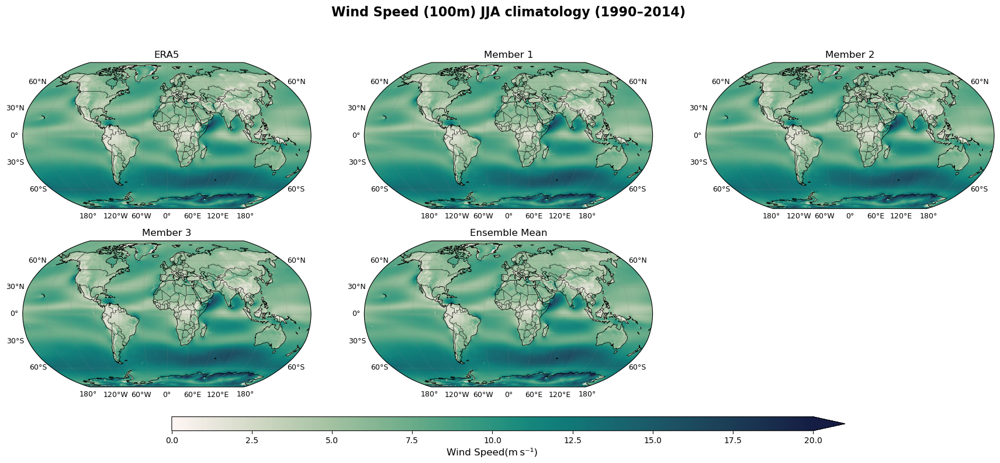

In [40]:
import cmocean
import xarray as xr
from glob import glob

# paths
era5_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_seasonal_climatology_1990_2014_JJA.nc"

ens_paths = sorted(
    glob("/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_climatology_a2g[bc,d]_regridded_to_era5_1990_2014_JJA.nc")
)
mean_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_climatology_ensemble_regridded_to_era5_1990_2014_JJA.nc"

# load member means (average over time dimension)
EAR5_mean=xr.open_dataset(era5_path)["windagl100"].mean("time")

members = [
    xr.open_dataset(p)["ws_regridded"].mean("time") for p in ens_paths
]

# load ensemble mean
ens_mean = xr.open_dataset(mean_path)["ws_seasonal_mean_ensemble"].mean("time")

# plot
plot_climatology_panels(
    da_list=[EAR5_mean]+ members + [ens_mean],
    titles=["ERA5", "Member 1", "Member 2", "Member 3", "Ensemble Mean"],
    vmin=0,
    vmax=20,
    cmap=cmocean.cm.tempo,
    extend="max",
    cbar_label="Wind Speed(m s⁻¹)",
    fig_title="Wind Speed (100m) JJA climatology (1990–2014)",
    projection="robinson",
    grid_interval=30,   # optional: 30° × 30° grid
)


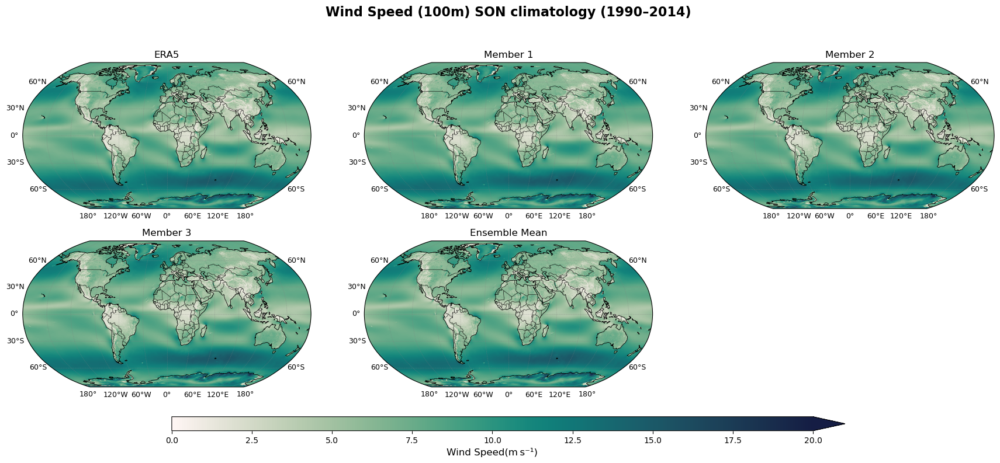

In [41]:
import cmocean
import xarray as xr
from glob import glob

# paths
era5_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_seasonal_climatology_1990_2014_SON.nc"

ens_paths = sorted(
    glob("/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_climatology_a2g[bc,d]_regridded_to_era5_1990_2014_SON.nc")
)
mean_path = "/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_climatology_ensemble_regridded_to_era5_1990_2014_SON.nc"

# load member means (average over time dimension)
EAR5_mean=xr.open_dataset(era5_path)["windagl100"].mean("time")

members = [
    xr.open_dataset(p)["ws_regridded"].mean("time") for p in ens_paths
]

# load ensemble mean
ens_mean = xr.open_dataset(mean_path)["ws_seasonal_mean_ensemble"].mean("time")

# plot
plot_climatology_panels(
    da_list=[EAR5_mean]+ members + [ens_mean],
    titles=["ERA5", "Member 1", "Member 2", "Member 3", "Ensemble Mean"],
    vmin=0,
    vmax=20,
    cmap=cmocean.cm.tempo,
    extend="max",
    cbar_label="Wind Speed(m s⁻¹)",
    fig_title="Wind Speed (100m) SON climatology (1990–2014)",
    projection="robinson",
    grid_interval=30,   # optional: 30° × 30° grid
)


- **Freeze run (a24r)**  
  *Period:* 1990–2019 (30 years)  
  *Model:* IFS-NEMO  
  *Resolution:* Global, 10 km horizontal  


#### Files Used

1. **Reference Data:** Monthly mean of ERA5 *(Postprocessed)*  
2. **Climate DT:** Monthly mean of historical ensemble and historical freeze-run *(Postprocessed)*

#### Variable of Interest

- **Wind speed at 100 m**

In [42]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.util import add_cyclic_point
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap
import matplotlib.ticker as mticker


def plot_era_model_grid(
    *,
    era_list,                     # top‑row DataArrays  (lat, lon)
    model_list,                   # bottom‑row DataArrays (same length/order)
    col_titles,                   # list of column titles  (e.g. ["Year", "DJF", …])
    era_suffix="ERA5",           # what to append to top‑row title
    model_suffix="IFS NEMO",         # what to append to bottom‑row title
    vmin, vmax,                   # colour‑scale limits
    cmap="YlGnBu",
    extend=None,                  # colour‑bar arrows: "neither"|"min"|"max"|"both"
    cbar_label="",
    fig_title=None,
    projection="robinson",
    grid_interval=None,           # e.g. 30  →  30 °× 30 ° grid
    hspace=0.42, wspace=0.12,     # row / column spacing
    label_mode="outer",           # "outer" | "all" (lat/lon tick labels)
):
    """
    Draw a 2 × N panel (N ≤ 5): ERA‑5 on top, Model on bottom.

    Parameters
    ----------
    era_list, model_list : list[xr.DataArray]
        • Same length (N) and dimensions (lat, lon).  
        • Order should match `col_titles`.
    col_titles : list[str]
        Titles for *columns* (seasons, annual, etc.).
    label_mode : "outer" | "all"
        • "outer": lat/lon tick labels only on left & bottom edges.  
        • "all":   labels on every subplot.
    """

    # ─────── checks ──────────────────────────────────────────────────────
    ncols = len(era_list)
    if ncols != len(model_list) or ncols != len(col_titles):
        raise ValueError("era_list, model_list, and col_titles must be same length.")
    if not (2 <= ncols <= 5):
        raise ValueError("supports 2–5 columns")

    proj = {
        "robinson": ccrs.Robinson(),
        "mollweide": ccrs.Mollweide(),
        "platecarree": ccrs.PlateCarree(),
    }.get(projection.lower(), ccrs.PlateCarree())

    cmap = get_cmap(cmap)
    norm = Normalize(vmin=vmin, vmax=vmax)

    fig, axes = plt.subplots(
        2, ncols, figsize=(5.2 * ncols, 6.2),
        subplot_kw=dict(projection=proj)
    )
    fig.subplots_adjust(hspace=hspace, wspace=wspace)

    # helper ─────────────────────────────────────────────────────────────
    def _pcolormesh(ax, da):
        data, lons = add_cyclic_point(da.values, coord=da.lon.values)
        lon2d, lat2d = np.meshgrid(lons, da.lat.values)
        return ax.pcolormesh(
            lon2d, lat2d, data,
            transform=ccrs.PlateCarree(), cmap=cmap, norm=norm
        )

    for j in range(ncols):
        # --- ERA‑5 (top)
        mesh = _pcolormesh(axes[0, j], era_list[j])
        axes[0, j].set_title(f"{col_titles[j]}: {era_suffix}", fontsize=11)

        # --- Model (bottom)
        _pcolormesh(axes[1, j], model_list[j])
        axes[1, j].set_title(f"{col_titles[j]}: {model_suffix}", fontsize=11)

        # --- embellishments
        for i, ax in enumerate((axes[0, j], axes[1, j])):
            ax.coastlines(linewidth=0.6)
            ax.add_feature(cfeature.BORDERS, linewidth=0.4)
            ax.add_feature(cfeature.LAND, facecolor="whitesmoke", edgecolor="black")

            # decide where to draw tick labels
            show_left   = (j == 0) or label_mode == "all"
            show_bottom = (i == 1) or label_mode == "all"

            gl = ax.gridlines(draw_labels=True,
                              linewidth=0.4, color="gray",
                              alpha=0.5, linestyle="--")
            gl.top_labels   = True
            gl.right_labels = True
            #gl.left_labels  = show_left
            #gl.bottom_labels = show_bottom
            gl.xlabel_style = gl.ylabel_style = {"size": 8}

            if grid_interval:
                gl.xlocator = mticker.FixedLocator(np.arange(-180, 181, grid_interval))
                gl.ylocator = mticker.FixedLocator(np.arange(-90,  91, grid_interval))

    # colour‑bar ──────────────────────────────────────────────────────────
    cax = fig.add_axes([0.15, 0.07, 0.7, 0.03])
    cbar = fig.colorbar(mesh, cax=cax, orientation="horizontal", extend=extend)
    cbar.set_label(cbar_label, fontsize=12)
    cbar.ax.tick_params(labelsize=10)

    axes[0, 0].set_ylabel(era_suffix, fontsize=12)
    axes[1, 0].set_ylabel(model_suffix, fontsize=12)

    if fig_title:
        plt.suptitle(fig_title, fontsize=17, fontweight="bold", y=0.985)

    plt.tight_layout(rect=[0, 0.11, 1, 0.94])
    plt.show()


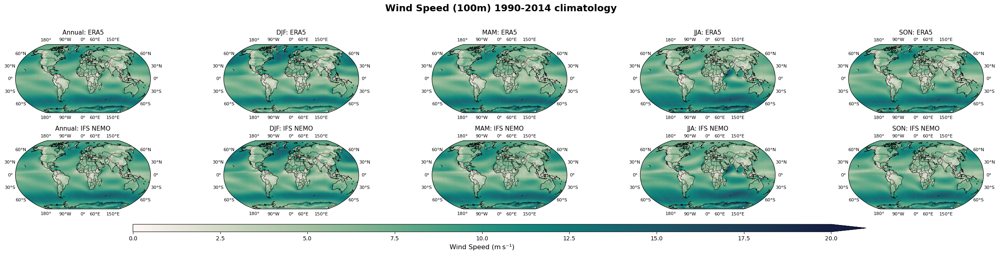

In [43]:
import cmocean
import xarray as xr

# ------------------- load ERA‑5 -------------------
era_year  = xr.open_dataset("/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_yearly_mean_1990_2014.nc")["windagl100_yearly_mean"].mean("time")      # (lat, lon)
era_DJF   = xr.open_dataset("/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_seasonal_climatology_1990_2014_DJF.nc")["windagl100"].mean("time")
era_MAM   = xr.open_dataset("/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_seasonal_climatology_1990_2014_MAM.nc")["windagl100"].mean("time")
era_JJA   = xr.open_dataset("/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_seasonal_climatology_1990_2014_JJA.nc")["windagl100"].mean("time")
era_SON   = xr.open_dataset("/gpfs/scratch/bsc32/bsc148104/hist_ensem/windagl100_seasonal_climatology_1990_2014_SON.nc")["windagl100"].mean("time")

# ------------------- load model -------------------
mod_year  = xr.open_dataset("/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_yearly_mean_historical_regridded_to_era5_1990_2014.nc")["ws_regridded"].mean("time") 
mod_DJF   = xr.open_dataset("/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_mean_historical_regridded_to_era5_1990_2014_DJF.nc")["ws_regridded"].mean("time")
mod_MAM   = xr.open_dataset("/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_mean_historical_regridded_to_era5_1990_2014_MAM.nc")["ws_regridded"].mean("time")
mod_JJA   = xr.open_dataset("/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_mean_historical_regridded_to_era5_1990_2014_JJA.nc")["ws_regridded"].mean("time")
mod_SON   = xr.open_dataset("/gpfs/scratch/bsc32/bsc148104/hist_ensem/ws_seasonal_mean_historical_regridded_to_era5_1990_2014_SON.nc")["ws_regridded"].mean("time")

plot_era_model_grid(
    era_list   = [era_year, era_DJF, era_MAM, era_JJA, era_SON],
    model_list = [mod_year, mod_DJF, mod_MAM, mod_JJA, mod_SON],
    col_titles = ["Annual", "DJF", "MAM", "JJA", "SON"],
    vmin=0, vmax=20,
    cmap=cmocean.cm.tempo,
    extend="max",
    cbar_label="Wind Speed (m s⁻¹)",
    fig_title=" Wind Speed (100m) 1990‑2014 climatology",
    projection="robinson",
    grid_interval=30,
    hspace=0.5,          # more gap between rows
    wspace=0.02,         # gap between columns
    label_mode="outer",  # tick labels only on outer edges
)



In [44]:
import os
import numpy as np
import xarray as xr
from collections import OrderedDict

# --------------- CONFIGURE ONCE ------------------------------------------
BASE = "/gpfs/scratch/bsc32/bsc148104/hist_ensem"

era_files = OrderedDict(
    Year = f"{BASE}/windagl100_yearly_mean_1990_2014.nc",
    DJF  = f"{BASE}/windagl100_seasonal_climatology_1990_2014_DJF.nc",
    MAM  = f"{BASE}/windagl100_seasonal_climatology_1990_2014_MAM.nc",
    JJA  = f"{BASE}/windagl100_seasonal_climatology_1990_2014_JJA.nc",
    SON  = f"{BASE}/windagl100_seasonal_climatology_1990_2014_SON.nc",
)

model_files = OrderedDict(
    Year = f"{BASE}/ws_yearly_mean_historical_regridded_to_era5_1990_2014.nc",
    DJF  = f"{BASE}/ws_seasonal_mean_historical_regridded_to_era5_1990_2014_DJF.nc",
    MAM  = f"{BASE}/ws_seasonal_mean_historical_regridded_to_era5_1990_2014_MAM.nc",
    JJA  = f"{BASE}/ws_seasonal_mean_historical_regridded_to_era5_1990_2014_JJA.nc",
    SON  = f"{BASE}/ws_seasonal_mean_historical_regridded_to_era5_1990_2014_SON.nc",
)

# variables inside the files
ERA_VAR   = "windagl100"            # yearly file uses 'windagl100_yearly_mean'; we catch that below
MODEL_VAR = "ws_regridded"          # both yearly & seasonal files

# --------------- compute bias & rmse -------------------------------------
bias_list, rmse_list = [], []

for season, era_path in era_files.items():
    mod_path = model_files[season]
    if not (os.path.exists(era_path) and os.path.exists(mod_path)):
        raise FileNotFoundError(f"Missing file for season {season}")

    # open era‑5
    era_ds = xr.open_dataset(era_path)
    if season == "Year":   # yearly file has a different variable name
        era_da = era_ds.get("windagl100_yearly_mean").mean("time")
    else:
        era_da = era_ds[ERA_VAR].mean("time")

    # open model
    mod_da = xr.open_dataset(mod_path)[MODEL_VAR].mean("time")

    # align & compute
    mod_al, era_al = xr.align(mod_da, era_da, join="exact")
    bias = (mod_al - era_al)                                # mean bias (already 2‑D)
    rmse = np.sqrt((mod_al - era_al) ** 2)                  # RMSE (since single time slice)

    bias.name = f"bias_{season}"
    rmse.name = f"rmse_{season}"

    bias_list.append(bias)
    rmse_list.append(rmse)

    print(f"✓ computed bias & RMSE for {season}")

print("✅  five‑element bias_list and rmse_list are ready for plotting")


✓ computed bias & RMSE for Year
✓ computed bias & RMSE for DJF
✓ computed bias & RMSE for MAM
✓ computed bias & RMSE for JJA
✓ computed bias & RMSE for SON
✅  five‑element bias_list and rmse_list are ready for plotting


In [45]:
def _plot_row(
    da_list, titles,
    *,
    vmin, vmax, cmap, extend,
    cbar_label="",
    fig_title=None,
    projection="robinson",
    grid_interval=30,
):
    """Draw a single‑row (1×N) Cartopy panel with one shared colour‑bar."""
    n = len(da_list)
    proj = {"robinson": ccrs.Robinson(),
            "mollweide": ccrs.Mollweide(),
            "platecarree": ccrs.PlateCarree(),
            }.get(projection.lower(), ccrs.PlateCarree())

    fig, axes = plt.subplots(
        1, n, figsize=(5.0 * n, 3.5),
        subplot_kw=dict(projection=proj),
    )
    axes = np.atleast_1d(axes)

    norm = Normalize(vmin=vmin, vmax=vmax)
    cmap = get_cmap(cmap)

    def _mesh(ax, da):
        var, lons = add_cyclic_point(da.values, coord=da.lon.values)
        lon2d, lat2d = np.meshgrid(lons, da.lat.values)
        return ax.pcolormesh(
            lon2d, lat2d, var,
            transform=ccrs.PlateCarree(),
            cmap=cmap, norm=norm,
        )

    for ax, da, ttl in zip(axes, da_list, titles):
        mesh = _mesh(ax, da)
        ax.set_title(ttl, fontsize=11)

        ax.coastlines(linewidth=0.6)
        ax.add_feature(cfeature.BORDERS, linewidth=0.4)
        ax.add_feature(cfeature.LAND, facecolor="whitesmoke", edgecolor="black")

        gl = ax.gridlines(draw_labels=True, linewidth=0.4, color="gray",
                          alpha=0.5, linestyle="--")
        gl.right_labels = False
        gl.top_labels   = False
        gl.xlabel_style = gl.ylabel_style = {"size": 7}
        if grid_interval:
            gl.xlocator = mticker.FixedLocator(np.arange(-180, 181, grid_interval))
            gl.ylocator = mticker.FixedLocator(np.arange(-90,   91,  grid_interval))

    # colour‑bar
    cax = fig.add_axes([0.13, 0.005, 0.74, 0.04]) #(left, bottom, width, height)
    cbar = fig.colorbar(mesh, cax=cax, orientation="horizontal", extend=extend)
    cbar.set_label(cbar_label, fontsize=11)
    cbar.ax.tick_params(labelsize=9)

    if fig_title:
        fig.suptitle(fig_title, fontsize=14, fontweight="bold", y=0.97)

    plt.tight_layout(rect=[0, 0.08, 1, 0.93])
    plt.show()


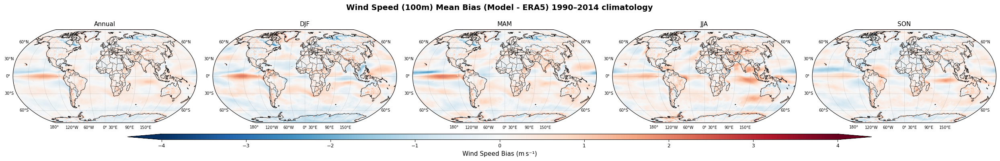

In [46]:
_plot_row(
    da_list     = bias_list,
    titles      = ["Annual", "DJF", "MAM", "JJA", "SON"],
    vmin=-4, vmax=4,
    cmap="RdBu_r", extend="both",
    cbar_label="Wind Speed Bias (m s⁻¹)",
    fig_title="Wind Speed (100m) Mean Bias (Model - ERA5) 1990–2014 climatology",
    projection="robinson",
    grid_interval=30,
)


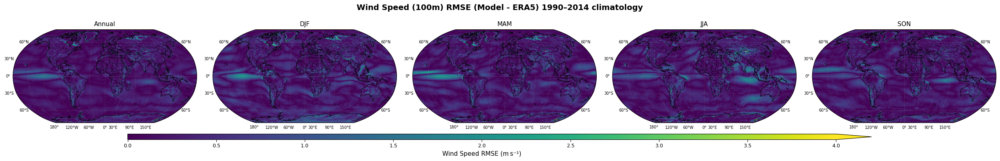

In [47]:
_plot_row(
    da_list     = rmse_list,
    titles      = ["Annual", "DJF", "MAM", "JJA", "SON"],
    vmin=0, vmax=4,
    cmap="viridis", extend="max",
    cbar_label="Wind Speed RMSE (m s⁻¹)",
    fig_title="Wind Speed (100m) RMSE (Model - ERA5) 1990–2014 climatology",
    projection="robinson",
    grid_interval=30,
)


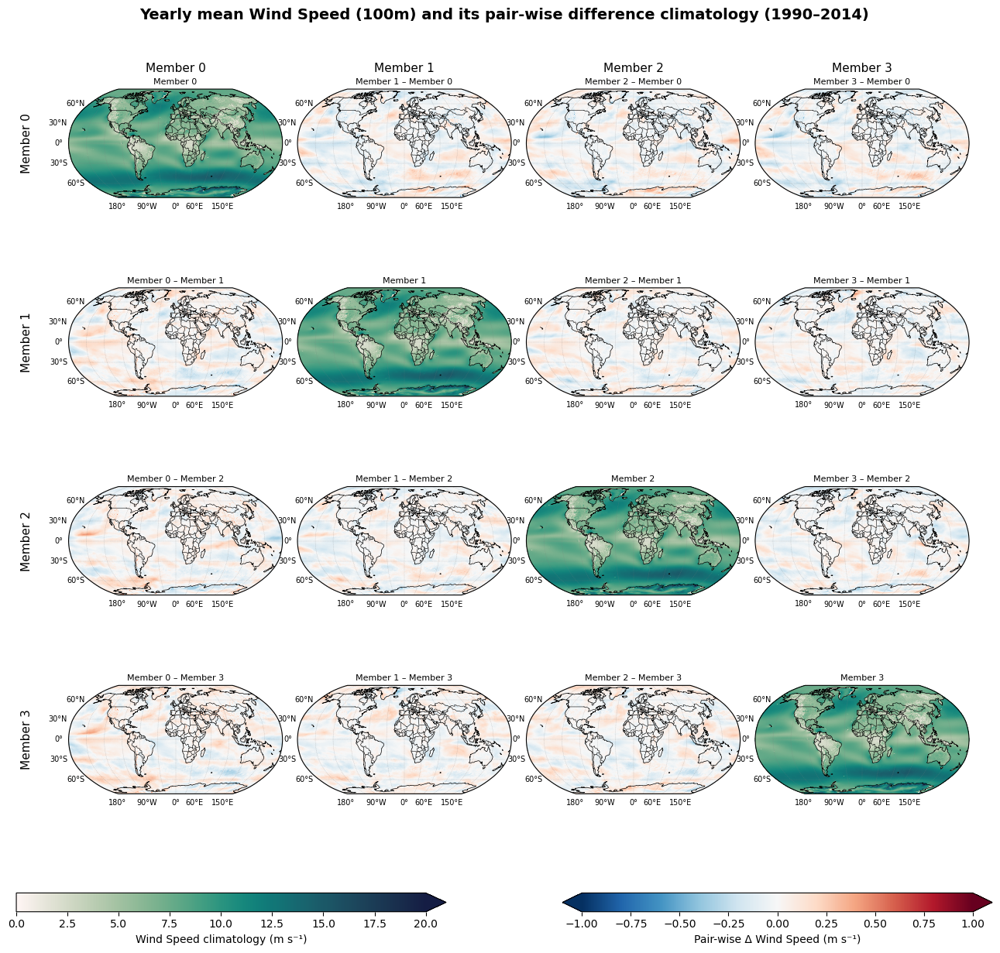

In [61]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.util import add_cyclic_point
import matplotlib.ticker as mticker
from matplotlib.colors import Normalize
import cmocean

# ─── 1.  Load 25-year means ─────────────────────────────────────────────
BASE = "/gpfs/scratch/bsc32/bsc148104/hist_ensem"
paths = dict(a2ga="100si_yearly_historical_1990_2014.nc",
             a2gb="ws_yearly_mean_a2gb_1990_2014.nc",
             a2gc="ws_yearly_mean_a2gc_1990_2014.nc",
             a2gd="ws_yearly_mean_a2gd_1990_2014.nc")
var   = dict(a2ga="100si_yearly_mean",
             a2gb="ws_yearly_mean",
             a2gc="ws_yearly_mean",
             a2gd="ws_yearly_mean")

means = {}
for tag, fname in paths.items():
    da = xr.open_dataset(os.path.join(BASE, fname))[var[tag]]
    means[tag] = da.isel(time=slice(0, 25)).mean("time")

tags   = ["a2ga", "a2gb", "a2gc", "a2gd"]
labels = ["Member 0", "Member 1", "Member 2", "Member 3"]

# ─── 2.  Build 4 × 4 matrix & colour limits ────────────────────────────
grid, clim_max, diff_max = [], 0, 0
for i, ti in enumerate(tags):
    row = []
    for j, tj in enumerate(tags):
        da = means[ti] if i == j else means[tj] - means[ti]
        row.append(da)
        if i == j:
            clim_max = max(clim_max, float(da.max()))
        else:
            diff_max = max(diff_max, float(np.abs(da).max()))
    grid.append(row)

#clim_norm = Normalize(0, np.ceil(clim_max * 10) / 10)
#diff_norm = Normalize(-diff_max, diff_max)

clim_norm = Normalize(0, 20)
diff_norm = Normalize(-1, 1)
# ─── 3.  Plot ───────────────────────────────────────────────────────────
proj = ccrs.Robinson()
fig, axes = plt.subplots(4, 4, figsize=(15, 13.5),
                         subplot_kw=dict(projection=proj))
fig.subplots_adjust(hspace=0.06, wspace=0.07, top=0.86)

for r in range(4):
    for c in range(4):
        ax  = axes[r, c]
        da  = grid[r][c]
        data, lons = add_cyclic_point(da.values, coord=da.lon.values)
        lon2d, lat2d = np.meshgrid(lons, da.lat.values)

        cmap = cmocean.cm.tempo if r == c else "RdBu_r"
        norm = clim_norm         if r == c else diff_norm
        mesh = ax.pcolormesh(lon2d, lat2d, data,
                             transform=ccrs.PlateCarree(),
                             cmap=cmap, norm=norm)

        # coast & land
        ax.coastlines(linewidth=0.5)
        ax.add_feature(cfeature.BORDERS, linewidth=0.4)
        ax.add_feature(cfeature.LAND, facecolor="whitesmoke",
                       edgecolor="black")

        # grid every 30 °
        gl = ax.gridlines(draw_labels=True, linewidth=0.3, color="gray",
                          alpha=0.4, linestyle="--")
        gl.xlocator = mticker.FixedLocator(np.arange(-180, 181, 30))
        gl.ylocator = mticker.FixedLocator(np.arange(-90,   91, 30))
        gl.xlabel_style = gl.ylabel_style = {"size": 7}
        gl.top_labels = gl.right_labels = False
        gl.left_labels = gl.bottom_labels = True

        # column heading
        if r == 0:
            ax.set_title(labels[c], fontsize=11, pad=16)

        # row heading (further left)
        if c == 0:
            ax.text(-0.17, 0.5, labels[r], transform=ax.transAxes,
                    va="center", ha="right", fontsize=11, rotation=90)

        # cell caption
        caption = labels[r] if r == c else f"{labels[c]} – {labels[r]}"
        ax.text(0.5, 1.03, caption, transform=ax.transAxes,
                ha="center", va="bottom", fontsize=8)

# ─── 4.  Colour-bars ────────────────────────────────────────────────────
cax1 = fig.add_axes([0.08, 0.035, 0.37, 0.018])
cb1  = fig.colorbar(axes[0, 0].collections[0], cax=cax1,
                    orientation="horizontal", extend="max")
cb1.set_label("Wind Speed climatology (m s⁻¹)", fontsize=10)

cax2 = fig.add_axes([0.55, 0.035, 0.37, 0.018])
cb2  = fig.colorbar(axes[0, 1].collections[0], cax=cax2,
                    orientation="horizontal", extend="both")
cb2.set_label("Pair-wise Δ Wind Speed (m s⁻¹)", fontsize=10)

fig.suptitle("Yearly mean Wind Speed (100m) and its pair-wise difference climatology (1990–2014)",
             fontsize=14, fontweight="bold", y=0.90)

plt.show()


### Climate Simulation

- **Freeze run Control (a24r)**  
  *Period:* 1990–2019 (30 years)  
  *Model:* IFS-NEMO  
  *Resolution:* Global, 10 km horizontal  

#### Files Used

1. **Reference Data:** Monthly mean of ERA5 *(Postprocessed)*  
2. **Climate DT:** Monthly mean of historical ensemble and historical freeze-run *(Postprocessed)*

#### Variable of Interest

- **Wind speed at 100 m**


In [64]:
import os
import numpy as np
import xarray as xr
from collections import OrderedDict

# --------------- CONFIGURE ONCE ------------------------------------------
BASE = "/gpfs/scratch/bsc32/bsc148104/hist_ensem"

era_files = OrderedDict(
    Year = f"{BASE}/windagl100_yearly_mean_1990_2014.nc",
    DJF  = f"{BASE}/windagl100_seasonal_climatology_1990_2014_DJF.nc",
    MAM  = f"{BASE}/windagl100_seasonal_climatology_1990_2014_MAM.nc",
    JJA  = f"{BASE}/windagl100_seasonal_climatology_1990_2014_JJA.nc",
    SON  = f"{BASE}/windagl100_seasonal_climatology_1990_2014_SON.nc",
)

model_files = OrderedDict(
    Year = f"{BASE}/ws_yearly_mean_control_regridded_to_era5_1990_2014.nc",
    DJF  = f"{BASE}/ws_seasonal_mean_control_regridded_to_era5_1990_2014_DJF.nc",
    MAM  = f"{BASE}/ws_seasonal_mean_control_regridded_to_era5_1990_2014_MAM.nc",
    JJA  = f"{BASE}/ws_seasonal_mean_control_regridded_to_era5_1990_2014_JJA.nc",
    SON  = f"{BASE}/ws_seasonal_mean_control_regridded_to_era5_1990_2014_SON.nc",
)

# variables inside the files
ERA_VAR   = "windagl100"            # yearly file uses 'windagl100_yearly_mean'; we catch that below
MODEL_VAR = "ws_regridded"          # both yearly & seasonal files

# --------------- compute bias & rmse -------------------------------------
bias_list, rmse_list = [], []

for season, era_path in era_files.items():
    mod_path = model_files[season]
    if not (os.path.exists(era_path) and os.path.exists(mod_path)):
        raise FileNotFoundError(f"Missing file for season {season}")

    # open era‑5
    era_ds = xr.open_dataset(era_path)
    if season == "Year":   # yearly file has a different variable name
        era_da = era_ds.get("windagl100_yearly_mean").mean("time")
    else:
        era_da = era_ds[ERA_VAR].mean("time")

    # open model
    mod_da = xr.open_dataset(mod_path)[MODEL_VAR].mean("time")

    # align & compute
    mod_al, era_al = xr.align(mod_da, era_da, join="exact")
    bias = (mod_al - era_al)                                # mean bias (already 2‑D)
    rmse = np.sqrt((mod_al - era_al) ** 2)                  # RMSE (since single time slice)

    bias.name = f"bias_{season}"
    rmse.name = f"rmse_{season}"

    bias_list.append(bias)
    rmse_list.append(rmse)

    print(f"✓ computed bias & RMSE for {season}")

print("✅  five‑element bias_list and rmse_list are ready for plotting")


✓ computed bias & RMSE for Year
✓ computed bias & RMSE for DJF
✓ computed bias & RMSE for MAM
✓ computed bias & RMSE for JJA
✓ computed bias & RMSE for SON
✅  five‑element bias_list and rmse_list are ready for plotting


In [65]:
def _plot_row(
    da_list, titles,
    *,
    vmin, vmax, cmap, extend,
    cbar_label="",
    fig_title=None,
    projection="robinson",
    grid_interval=30,
):
    """Draw a single‑row (1×N) Cartopy panel with one shared colour‑bar."""
    n = len(da_list)
    proj = {"robinson": ccrs.Robinson(),
            "mollweide": ccrs.Mollweide(),
            "platecarree": ccrs.PlateCarree(),
            }.get(projection.lower(), ccrs.PlateCarree())

    fig, axes = plt.subplots(
        1, n, figsize=(5.0 * n, 3.5),
        subplot_kw=dict(projection=proj),
    )
    axes = np.atleast_1d(axes)

    norm = Normalize(vmin=vmin, vmax=vmax)
    cmap = get_cmap(cmap)

    def _mesh(ax, da):
        var, lons = add_cyclic_point(da.values, coord=da.lon.values)
        lon2d, lat2d = np.meshgrid(lons, da.lat.values)
        return ax.pcolormesh(
            lon2d, lat2d, var,
            transform=ccrs.PlateCarree(),
            cmap=cmap, norm=norm,
        )

    for ax, da, ttl in zip(axes, da_list, titles):
        mesh = _mesh(ax, da)
        ax.set_title(ttl, fontsize=11)

        ax.coastlines(linewidth=0.6)
        ax.add_feature(cfeature.BORDERS, linewidth=0.4)
        ax.add_feature(cfeature.LAND, facecolor="whitesmoke", edgecolor="black")

        gl = ax.gridlines(draw_labels=True, linewidth=0.4, color="gray",
                          alpha=0.5, linestyle="--")
        gl.right_labels = False
        gl.top_labels   = False
        gl.xlabel_style = gl.ylabel_style = {"size": 7}
        if grid_interval:
            gl.xlocator = mticker.FixedLocator(np.arange(-180, 181, grid_interval))
            gl.ylocator = mticker.FixedLocator(np.arange(-90,   91,  grid_interval))

    # colour‑bar
    cax = fig.add_axes([0.13, 0.005, 0.74, 0.04]) #(left, bottom, width, height)
    cbar = fig.colorbar(mesh, cax=cax, orientation="horizontal", extend=extend)
    cbar.set_label(cbar_label, fontsize=11)
    cbar.ax.tick_params(labelsize=9)

    if fig_title:
        fig.suptitle(fig_title, fontsize=14, fontweight="bold", y=0.97)

    plt.tight_layout(rect=[0, 0.08, 1, 0.93])
    plt.show()


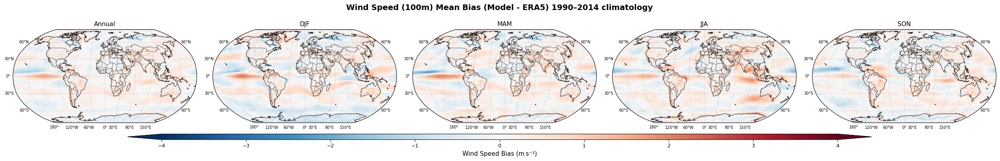

In [66]:
_plot_row(
    da_list     = bias_list,
    titles      = ["Annual", "DJF", "MAM", "JJA", "SON"],
    vmin=-4, vmax=4,
    cmap="RdBu_r", extend="both",
    cbar_label="Wind Speed Bias (m s⁻¹)",
    fig_title="Wind Speed (100m) Mean Bias (Model - ERA5) 1990–2014 climatology",
    projection="robinson",
    grid_interval=30,
)


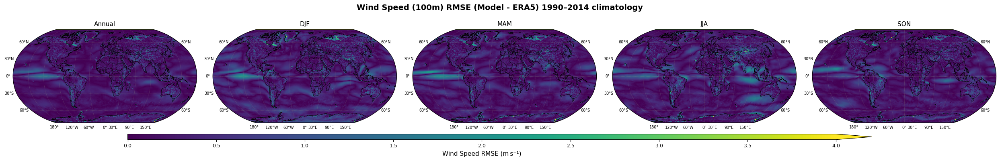

In [67]:
_plot_row(
    da_list     = rmse_list,
    titles      = ["Annual", "DJF", "MAM", "JJA", "SON"],
    vmin=0, vmax=4,
    cmap="viridis", extend="max",
    cbar_label="Wind Speed RMSE (m s⁻¹)",
    fig_title="Wind Speed (100m) RMSE (Model - ERA5) 1990–2014 climatology",
    projection="robinson",
    grid_interval=30,
)


**Difference from control simulation**

In [2]:
import xarray as xr
import numpy as np
import os

# Define input paths
input_dir = "/gpfs/scratch/bsc32/bsc148104/hist_ensem"

# Historical ensemble files
hist_files = {
    "a2gb": os.path.join(input_dir, "ws_yearly_mean_a2gb_1990_2014.nc"),
    "a2gc": os.path.join(input_dir, "ws_yearly_mean_a2gc_1990_2014.nc"),
    "a2gd": os.path.join(input_dir, "ws_yearly_mean_a2gd_1990_2014.nc")
}

# Historical freeze (ensemble 0)
freeze_file = os.path.join(input_dir, "100si_yearly_historical_1990_2014.nc")

# Control file
control_file = os.path.join(input_dir, "100si_yearly_control_1990_2014.nc")

# Load control and truncate to 25 years
control_ds = xr.open_dataset(control_file)
control = control_ds["100si_yearly_mean"].isel(time=slice(0, 25))
control_mean = control.mean(dim="time")
control_std = control.std(dim="time")

# Load historical freeze (ensemble 0)
freeze_ds = xr.open_dataset(freeze_file)
freeze = freeze_ds["100si_yearly_mean"].isel(time=slice(0, 25))
freeze_mean = freeze.mean(dim="time")

# Compute difference and z-score for freeze
diff_freeze = freeze_mean - control_mean
z_freeze = diff_freeze / control_std

# Load individual ensemble members
ensemble_means = {}
ensemble_diffs = {}
ensemble_zscores = {}
all_members = []

for name, path in hist_files.items():
    ds = xr.open_dataset(path)
    member = ds["ws_yearly_mean"]
    member = member.isel(time=slice(0, 25))
    member_mean = member.mean(dim="time")
    diff = member_mean - control_mean
    zscore = diff / control_std

    ensemble_means[name] = member_mean
    ensemble_diffs[name] = diff
    ensemble_zscores[name] = zscore
    all_members.append(member)

# Compute ensemble mean from a2gb, a2gc, a2gd
ensemble_stack = xr.concat(all_members, dim="member")
ensemble_mean_combined = ensemble_stack.mean(dim=["time", "member"])
ensemble_diff_combined = ensemble_mean_combined - control_mean
ensemble_z_combined = ensemble_diff_combined / control_std



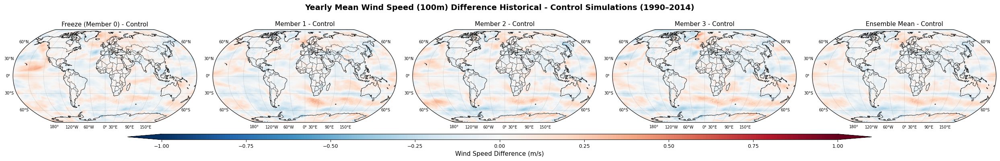

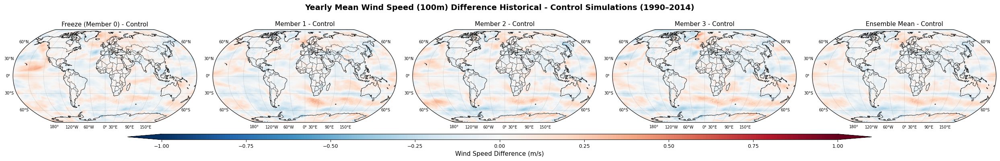

In [5]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.util import add_cyclic_point
import matplotlib.ticker as mticker
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap
%matplotlib inline

# Define the plotting function (copied from user input)
def _plot_row(
    da_list, titles,
    *,
    vmin, vmax, cmap, extend,
    cbar_label="",
    fig_title=None,
    projection="robinson",
    grid_interval=30,
):
    """Draw a single‑row (1×N) Cartopy panel with one shared colour‑bar."""
    n = len(da_list)
    proj = {"robinson": ccrs.Robinson(),
            "mollweide": ccrs.Mollweide(),
            "platecarree": ccrs.PlateCarree(),
            }.get(projection.lower(), ccrs.PlateCarree())

    fig, axes = plt.subplots(
        1, n, figsize=(5.0 * n, 3.5),
        subplot_kw=dict(projection=proj),
    )
    axes = np.atleast_1d(axes)

    norm = Normalize(vmin=vmin, vmax=vmax)
    cmap = get_cmap(cmap)

    def _mesh(ax, da):
        var, lons = add_cyclic_point(da.values, coord=da.lon.values)
        lon2d, lat2d = np.meshgrid(lons, da.lat.values)
        return ax.pcolormesh(
            lon2d, lat2d, var,
            transform=ccrs.PlateCarree(),
            cmap=cmap, norm=norm,
        )

    for ax, da, ttl in zip(axes, da_list, titles):
        mesh = _mesh(ax, da)
        ax.set_title(ttl, fontsize=11)

        ax.coastlines(linewidth=0.6)
        ax.add_feature(cfeature.BORDERS, linewidth=0.4)
        ax.add_feature(cfeature.LAND, facecolor="whitesmoke", edgecolor="black")

        gl = ax.gridlines(draw_labels=True, linewidth=0.4, color="gray",
                          alpha=0.5, linestyle="--")
        gl.right_labels = False
        gl.top_labels   = False
        gl.xlabel_style = gl.ylabel_style = {"size": 7}
        if grid_interval:
            gl.xlocator = mticker.FixedLocator(np.arange(-180, 181, grid_interval))
            gl.ylocator = mticker.FixedLocator(np.arange(-90,   91,  grid_interval))

    # colour‑bar
    cax = fig.add_axes([0.13, 0.002, 0.74, 0.04]) #(left, bottom, width, height)
    cbar = fig.colorbar(mesh, cax=cax, orientation="horizontal", extend=extend)
    cbar.set_label(cbar_label, fontsize=11)
    cbar.ax.tick_params(labelsize=9)

    if fig_title:
        fig.suptitle(fig_title, fontsize=14, fontweight="bold", y=0.97)

    plt.tight_layout(rect=[0, 0.08, 1, 0.93])
    plt.show()

# Plot the 5 gridded differences using the plotting function
_plot_row(
    da_list=[
        diff_freeze,
        ensemble_diffs["a2gb"],
        ensemble_diffs["a2gc"],
        ensemble_diffs["a2gd"],
        ensemble_diff_combined
    ],
    titles=[
        "Freeze (Member 0) - Control",
        "Member 1 - Control",
        "Member 2 - Control",
        "Member 3 - Control",
        "Ensemble Mean - Control"
    ],
    vmin=-1.0, vmax=1.0,
    cmap="RdBu_r",
    extend="both",
    cbar_label="Wind Speed Difference (m/s)",
    fig_title="Yearly Mean Wind Speed (100m) Difference Historical - Control Simulations (1990–2014)",
    projection="robinson"
)
